<a href="https://colab.research.google.com/github/JAgrit20/Thesis_Codes/blob/main/RQ1_Exp_2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [26]:
import pandas as pd

# Load the data
data = pd.read_csv('bug_comments.csv')

# Group by 'Bug ID' and collect all 'Comment Text' in lists
grouped_comments = data.groupby('Bug ID')['Comment Text'].apply(list).reset_index()

# Convert to dictionary for easy access if needed
comments_dict = dict(zip(grouped_comments['Bug ID'], grouped_comments['Comment Text']))


In [28]:
print(comments_dict)

{10212: ["Height: 100% does not work when nesting tables (Width: 100% works OK), meaning\nthat the inner table is not utilizing the full height of the cell of the parent\ntable it is located in.\n\nThis problem has always been there (I looked it from builds M5 to M8).\n\nI met this problem as my application depends on it. I was using the W3 site as\nCSS reference.  The example below shows that 100% works for Width and does not\nfor Height:           (It works OK on IE5)\n<HTML>\n\n<HEAD><STYLE>\nTABLE {height: 100%; width: 100%}\nTD { border: 1px inset steelblue}\n</STYLE></HEAD>\n\n<BODY><TABLE style='height: auto; width: auto'>\n  <TBODY>\n  <TR>\n    <TD>Cell 1,1</TD>\n    <TD>\n      <TABLE>\n        <TBODY>\n        <TR>\n          <TD>Cell 1,1</TD>\n          <TD>Cell 1,2</TD>\n          <TD>Cell 1,3</TD></TR>\n        <TR>\n          <TD>Cell 2,1</TD>\n          <TD>Cell 2,2</TD>\n          <TD>Cell 2,3</TD></TR>\n        <TR>\n          <TD>Cell 3,1</TD>\n          <TD>Cell 3,2

In [29]:

# Group by 'Bug ID' and collect all 'Comment Text' in lists
grouped_comments = data.groupby('Bug ID')['Comment Text'].apply(list).reset_index()

# Filter out groups where the first comment does not contain 'Steps to Reproduce'
# Ensure that each list is not empty and the first item is a string
filtered_comments = grouped_comments[grouped_comments['Comment Text'].apply(
    lambda x: 'Steps to Reproduce' in x[0] if x and isinstance(x[0], str) else False
)]

# Convert to dictionary for easy access
comments_dict = dict(zip(filtered_comments['Bug ID'], filtered_comments['Comment Text']))

# Display the filtered results
print(filtered_comments.head())
print(filtered_comments.count())


    Bug ID                                       Comment Text
5    32736  [From Bugzilla Helper:\nUser-Agent: Mozilla/5....
6    37540  [Guessing here on the component, pls reassign ...
7    38655  [From Bugzilla Helper:\nUser-Agent: Mozilla/4....
9    40098  [From Bugzilla Helper:\nUser-Agent: Mozilla/5....
10   41675  [From Bugzilla Helper:\nUser-Agent: Mozilla/5....
Bug ID          323
Comment Text    323
dtype: int64


In [30]:
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
import string

# Download necessary NLTK resources
nltk.download('punkt')
nltk.download('stopwords')

# Function to preprocess text for sentiment analysis
def preprocess_text(text):
    # Tokenize text
    tokens = word_tokenize(text)
    # Lowercase
    tokens = [token.lower() for token in tokens]
    # Remove punctuation
    table = str.maketrans('', '', string.punctuation)
    stripped_tokens = [token.translate(table) for token in tokens]
    # Remove non-alphabetic tokens and stopwords
    words = [word for word in stripped_tokens if word.isalpha() and word not in stopwords.words('english')]
    return ' '.join(words)  # Join the tokens back into a string for VADER analysis

# Apply preprocessing to each comment in the dictionary, skipping the first comment of each list
preprocessed_comments = {}
for bug_id, comments in comments_dict.items():
    # Skip the first comment
    preprocessed_comments[bug_id] = [preprocess_text(comment) for comment in comments[1:]]

# Display sample of preprocessed comments
for bug_id, processed_texts in preprocessed_comments.items():
    print(f"Bug ID: {bug_id}")
    for text in processed_texts:
        print(text)
    break  # Just showing the first Bug ID's texts, remove this to see all


[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


Bug ID: 32736
aha still happens pages using semiopacity even quickly afaics adam
reassigning pavlov triage
give page crash
yes master pavlov yes http
view manager calling blend rect width andor height cause bad things happen
checks blending rect
still crashes url retested yet gdkerror badmatch invalid parameter attributes serial errorcode requestcode minorcode fresh cvs bst cursory search ca nt find x request matching code perhaps belongs extention
ok seeing bug argh running gtk xfree chance
hi running gtk
massmoving nonfeature bugs still consider part
forefully disabled use ie turn nt really going mark bug fixed file new bug shm stuff nt work anymore
better yet going change title
moving
massmoving bugs dofood
working yet
getting work speed image drawing things bit linux fairly easy fix since work long time ago
bug marked duplicate bug
insofar fix top performance issues like ui sluggishness
also configure changed default rather
believe code provided real speedup product therefore marki

In [31]:
# import nltk
# from nltk.corpus import stopwords
# from nltk.stem import PorterStemmer, WordNetLemmatizer
# from nltk.tokenize import word_tokenize
# import string

# # Download necessary NLTK resources
# nltk.download('punkt')
# nltk.download('stopwords')
# nltk.download('wordnet')

# # Initialize objects for stemming and lemmatization
# ps = PorterStemmer()
# lemmatizer = WordNetLemmatizer()

# # Function to preprocess text
# def preprocess_text(text):
#     # Tokenize text
#     tokens = word_tokenize(text)
#     # Lowercase
#     tokens = [token.lower() for token in tokens]
#     # Remove punctuation
#     table = str.maketrans('', '', string.punctuation)
#     stripped_tokens = [token.translate(table) for token in tokens]
#     # Remove non-alphabetic tokens and stopwords
#     words = [word for word in stripped_tokens if word.isalpha() and word not in stopwords.words('english')]
#     # Stemming
#     stemmed = [ps.stem(word) for word in words]
#     # Lemmatization
#     lemmatized = [lemmatizer.lemmatize(word) for word in stemmed]
#     return lemmatized

# # Apply preprocessing to each comment in the dictionary, skipping the first comment of each list
# preprocessed_comments = {}
# for bug_id, comments in comments_dict.items():
#     # Skip the first comment
#     preprocessed_comments[bug_id] = [preprocess_text(comment) for comment in comments[1:]]

# # Display sample of preprocessed comments
# for bug_id, processed_texts in preprocessed_comments.items():
#     print(f"Bug ID: {bug_id}")
#     for text in processed_texts:
#         print(text)
#     break  # Just showing the first Bug ID's texts, remove this to see all


In [32]:
print(preprocessed_comments)

{32736: ['aha still happens pages using semiopacity even quickly afaics adam', 'reassigning pavlov triage', 'give page crash', 'yes master pavlov yes http', 'view manager calling blend rect width andor height cause bad things happen', 'checks blending rect', 'still crashes url retested yet gdkerror badmatch invalid parameter attributes serial errorcode requestcode minorcode fresh cvs bst cursory search ca nt find x request matching code perhaps belongs extention', 'ok seeing bug argh running gtk xfree chance', 'hi running gtk', 'massmoving nonfeature bugs still consider part', 'forefully disabled use ie turn nt really going mark bug fixed file new bug shm stuff nt work anymore', 'better yet going change title', 'moving', 'massmoving bugs dofood', 'working yet', 'getting work speed image drawing things bit linux fairly easy fix since work long time ago', 'bug marked duplicate bug', 'insofar fix top performance issues like ui sluggishness', 'also configure changed default rather', 'belie

In [11]:
!pip install nltk
import nltk
nltk.download('vader_lexicon')


[nltk_data] Downloading package vader_lexicon to /root/nltk_data...


True

In [44]:
import nltk
from nltk.tokenize import word_tokenize
from nltk.sentiment import SentimentIntensityAnalyzer

# Download necessary NLTK resources (if not already done in your environment)
nltk.download('punkt')

# Initialize VADER
sia = SentimentIntensityAnalyzer()

# Function to preprocess text for sentiment analysis
def preprocess_text(text):
    # Tokenize text while retaining essential punctuation that can influence sentiment
    tokens = word_tokenize(text)
    # Lowercase and filter out unwanted characters while preserving punctuation important for sentiment
    tokens = [token.lower() for token in tokens if token.isalpha() or token in ['!', '?', '.']]
    return ' '.join(tokens)  # Join the tokens back into a string for VADER analysis

# Function to apply sentiment analysis
def analyze_sentiment(comments):
    sentiment_scores = {}
    for bug_id, comment_texts in comments.items():
        processed_texts = [preprocess_text(comment) for comment in comment_texts]
        # Analyze each preprocessed comment
        scores = [sia.polarity_scores(text) for text in processed_texts]
        sentiment_scores[bug_id] = scores
    return sentiment_scores

# Apply preprocessing and sentiment analysis to the comments
# Assuming 'comments_dict' is already filled with your comments data
preprocessed_comments = {}
for bug_id, comments in comments_dict.items():
    preprocessed_comments[bug_id] = [preprocess_text(comment) for comment in comments]

sentiment_results = analyze_sentiment(preprocessed_comments)

# Display sentiment analysis results for the first few Bug IDs
for bug_id, scores in list(sentiment_results.items())[:5]:
    print(f"Bug ID: {bug_id}")
    for score in scores:
        print(score)


[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


Bug ID: 32736
{'neg': 0.037, 'neu': 0.895, 'pos': 0.067, 'compound': 0.296}
{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}
{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}
{'neg': 0.252, 'neu': 0.748, 'pos': 0.0, 'compound': -0.4019}
{'neg': 0.0, 'neu': 0.426, 'pos': 0.574, 'compound': 0.6597}
{'neg': 0.171, 'neu': 0.829, 'pos': 0.0, 'compound': -0.5423}
{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}
{'neg': 0.0, 'neu': 0.935, 'pos': 0.065, 'compound': 0.3182}
{'neg': 0.0, 'neu': 0.802, 'pos': 0.198, 'compound': 0.4939}
{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}
{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}
{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}
{'neg': 0.0, 'neu': 0.707, 'pos': 0.293, 'compound': 0.4404}
{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}
{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}
{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}
{'neg': 0.0, 'neu': 0.914, 'pos': 0.086, 'compound': 0.4404}
{'neg': 0

In [45]:
count_keys = len(comments_dict)
print(count_keys)

323


In [49]:
from nltk.sentiment import SentimentIntensityAnalyzer
import nltk
from nltk.tokenize import word_tokenize
import numpy as np

# Download necessary NLTK resources
nltk.download('punkt')

# Initialize VADER
sia = SentimentIntensityAnalyzer()

# Function to preprocess text for sentiment analysis
def preprocess_text(text):
    # Tokenize text while retaining essential punctuation that can influence sentiment
    tokens = word_tokenize(text)
    # Lowercase and filter out unwanted characters while preserving punctuation important for sentiment
    tokens = [token.lower() for token in tokens if token.isalpha() or token in ['!', '?', '.']]
    return ' '.join(tokens)  # Join the tokens back into a string for VADER analysis

# Function to apply sentiment analysis and aggregate sentiment by bug ID
def analyze_sentiment(comments):
    bug_id_sentiments = {}
    for bug_id, comment_texts in comments.items():
        # Preprocess and analyze each comment for the bug ID
        compound_scores = []
        for comment in comment_texts:
            processed_text = preprocess_text(comment)
            score = sia.polarity_scores(processed_text)
            compound_scores.append(score['compound'])

        # Average the compound scores to get the overall sentiment for the bug ID
        if compound_scores:
            average_score = np.mean(compound_scores)
        else:
            average_score = 0  # Default to neutral if no comments are processed

        # Categorize the overall sentiment
        if average_score >= 0.05:
            overall_sentiment = 'positive'
        elif average_score <= -0.05:
            overall_sentiment = 'negative'
        else:
            overall_sentiment = 'neutral'

        bug_id_sentiments[bug_id] = overall_sentiment

    return bug_id_sentiments

# Apply preprocessing and sentiment analysis to the comments
# Assuming 'comments_dict' is already filled with your comments data
bug_id_sentiments = analyze_sentiment(comments_dict)

# Count the overall sentiments for each bug ID
sentiment_counts = {'positive': 0, 'neutral': 0, 'negative': 0}
for sentiment in bug_id_sentiments.values():
    sentiment_counts[sentiment] += 1

# Display the sentiment counts for each category
print("Sentiment counts:")
print("Positive: ", sentiment_counts['positive'])
print("Neutral: ", sentiment_counts['neutral'])
print("Negative: ", sentiment_counts['negative'])


[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


Sentiment counts:
Positive:  201
Neutral:  54
Negative:  68


In [51]:
from nltk.sentiment import SentimentIntensityAnalyzer
import nltk
from nltk.tokenize import word_tokenize
import numpy as np

# Download necessary NLTK resources
nltk.download('punkt')

# Initialize VADER
sia = SentimentIntensityAnalyzer()

# Function to preprocess text for sentiment analysis
def preprocess_text(text):
    # Tokenize text while retaining essential punctuation that can influence sentiment
    tokens = word_tokenize(text)
    # Lowercase and filter out unwanted characters while preserving punctuation important for sentiment
    tokens = [token.lower() for token in tokens if token.isalpha() or token in ['!', '?', '.']]
    return ' '.join(tokens)  # Join the tokens back into a string for VADER analysis

# Function to apply sentiment analysis and aggregate sentiment by bug ID
def analyze_sentiment(comments):
    bug_id_sentiments = {}
    for bug_id, comment_texts in comments.items():
        # Preprocess and analyze each comment for the bug ID
        compound_scores = []
        for comment in comment_texts:
            processed_text = preprocess_text(comment)
            score = sia.polarity_scores(processed_text)
            compound_scores.append(score['compound'])

        # Average the compound scores to get the overall sentiment for the bug ID
        if compound_scores:
            average_score = np.mean(compound_scores)
        else:
            average_score = 0  # Default to neutral if no comments are processed

        # Categorize the overall sentiment
        if average_score >= 0.05:
            overall_sentiment = 'positive'
        elif average_score <= -0.05:
            overall_sentiment = 'negative'
        else:
            overall_sentiment = 'neutral'

        bug_id_sentiments[bug_id] = overall_sentiment

    return bug_id_sentiments

# Apply preprocessing and sentiment analysis to the comments
# Assuming 'comments_dict' is already filled with your comments data
bug_id_sentiments = analyze_sentiment(comments_dict)

# Organize the bug IDs by sentiment
sentiment_categories = {'positive': [], 'neutral': [], 'negative': []}
for bug_id, sentiment in bug_id_sentiments.items():
    sentiment_categories[sentiment].append(bug_id)

# Display the bug IDs for each sentiment category
print("Positive Bug IDs:", sentiment_categories['positive'])
print("Neutral Bug IDs:", sentiment_categories['neutral'])
print("Negative Bug IDs:", sentiment_categories['negative'])


[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


Positive Bug IDs: [32736, 40098, 41675, 44959, 46254, 56418, 59844, 61174, 75061, 77399, 85165, 85686, 86012, 87253, 102981, 104449, 114954, 125560, 133465, 136676, 136714, 141801, 144350, 145405, 145419, 150134, 151504, 155594, 156089, 156496, 158633, 159259, 163491, 172357, 178721, 182286, 186533, 186664, 188328, 191303, 191866, 192734, 193496, 201056, 204606, 208685, 211051, 215719, 221824, 224970, 226403, 227632, 236630, 237877, 238835, 240610, 241042, 249338, 250906, 257870, 260642, 265088, 266338, 286933, 289823, 294651, 306585, 307339, 308064, 308565, 309108, 315174, 320438, 324021, 325705, 333564, 338240, 338542, 351216, 360148, 367023, 375171, 406157, 407128, 407793, 408372, 409196, 411517, 414211, 416766, 417720, 429043, 429827, 430105, 431098, 433730, 433966, 433971, 434174, 435932, 442139, 443800, 444165, 444515, 446670, 447794, 448178, 448917, 449689, 450140, 453120, 454782, 457625, 458051, 460460, 463686, 468358, 471802, 472037, 473002, 477415, 477803, 477982, 483192, 492

In [47]:
# from nltk.sentiment import SentimentIntensityAnalyzer
# import numpy as np

# # Initialize VADER
# sia = SentimentIntensityAnalyzer()

# # Function to apply sentiment analysis and average scores
# def analyze_sentiment(comments):
#     averaged_sentiment_scores = {}
#     for bug_id, texts in comments.items():
#         # Analyze each preprocessed comment
#         compound_scores = [sia.polarity_scores(' '.join(text))['compound'] for text in texts]

#         # Calculate the average compound score for the bug ID if there are any scores
#         if compound_scores:
#             average_score = np.mean(compound_scores)
#         else:
#             average_score = 0  # Default to neutral if no comments are processed

#         # Determine the overall sentiment from the average compound score
#         if average_score >= 0.05:
#             sentiment = 'positive'
#         elif average_score <= -0.05:
#             sentiment = 'negative'
#         else:
#             sentiment = 'neutral'

#         # Store the average sentiment score
#         averaged_sentiment_scores[bug_id] = (average_score, sentiment)

#     return averaged_sentiment_scores

# # Apply sentiment analysis to the preprocessed comments
# sentiment_results = analyze_sentiment(preprocessed_comments)

# # Display the aggregated sentiment results for the first few Bug IDs
# for bug_id, (score, sentiment) in list(sentiment_results.items())[:5]:
#     print(f"Bug ID: {bug_id}, Average Compound Score: {score}, Overall Sentiment: {sentiment}")


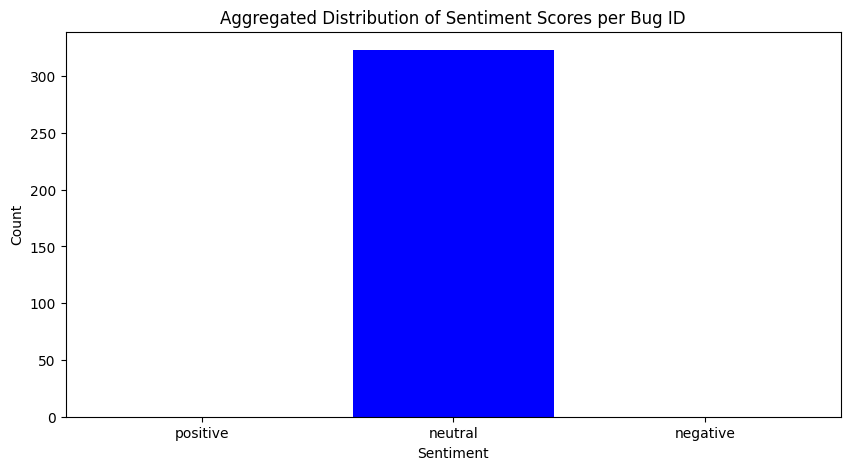

In [41]:
# import matplotlib.pyplot as plt
# from nltk.sentiment import SentimentIntensityAnalyzer
# import numpy as np

# # Initialize VADER
# sia = SentimentIntensityAnalyzer()

# # Function to apply sentiment analysis and average scores
# def analyze_sentiment(comments):
#     averaged_sentiment_scores = {}
#     for bug_id, texts in comments.items():
#         # Analyze each preprocessed comment
#         compound_scores = [sia.polarity_scores(' '.join(text))['compound'] for text in texts]

#         # Calculate the average compound score for the bug ID if there are any scores
#         if compound_scores:
#             average_score = np.mean(compound_scores)
#         else:
#             average_score = 0  # Default to neutral if no comments are processed

#         # Determine the overall sentiment from the average compound score
#         if average_score >= 0.05:
#             sentiment = 'positive'
#         elif average_score <= -0.05:
#             sentiment = 'negative'
#         else:
#             sentiment = 'neutral'

#         # Store the average sentiment score
#         averaged_sentiment_scores[bug_id] = (average_score, sentiment)

#     return averaged_sentiment_scores

# # Apply sentiment analysis to the preprocessed comments
# sentiment_results = analyze_sentiment(preprocessed_comments)

# # Calculate sentiment counts
# sentiment_counts = {'positive': 0, 'neutral': 0, 'negative': 0}
# for _, sentiment in sentiment_results.values():
#     sentiment_counts[sentiment] += 1

# # Plotting the sentiment counts
# plt.figure(figsize=(10, 5))
# plt.bar(sentiment_counts.keys(), sentiment_counts.values(), color=['green', 'blue', 'red'])
# plt.xlabel('Sentiment')
# plt.ylabel('Count')
# plt.title('Aggregated Distribution of Sentiment Scores per Bug ID')
# plt.show()


In [37]:
print(preprocessed_comments)

{32736: ['aha still happens pages using semiopacity even quickly afaics adam', 'reassigning pavlov triage', 'give page crash', 'yes master pavlov yes http', 'view manager calling blend rect width andor height cause bad things happen', 'checks blending rect', 'still crashes url retested yet gdkerror badmatch invalid parameter attributes serial errorcode requestcode minorcode fresh cvs bst cursory search ca nt find x request matching code perhaps belongs extention', 'ok seeing bug argh running gtk xfree chance', 'hi running gtk', 'massmoving nonfeature bugs still consider part', 'forefully disabled use ie turn nt really going mark bug fixed file new bug shm stuff nt work anymore', 'better yet going change title', 'moving', 'massmoving bugs dofood', 'working yet', 'getting work speed image drawing things bit linux fairly easy fix since work long time ago', 'bug marked duplicate bug', 'insofar fix top performance issues like ui sluggishness', 'also configure changed default rather', 'belie

In [50]:
from nltk.sentiment import SentimentIntensityAnalyzer
import numpy as np

# Initialize VADER
sia = SentimentIntensityAnalyzer()

# Function to analyze sentiment and provide detailed debugging for a specific bug ID
def analyze_sentiment_debug(comments, debug_bug_id):
    detailed_debug_info = {}
    for bug_id, texts in comments.items():
        # Analyze each preprocessed comment
        scores = []
        debug_details = []
        for text in texts:
            joined_text = ' '.join(text)  # Join the tokens back into a string for VADER analysis
            score = sia.polarity_scores(joined_text)
            scores.append(score['compound'])
            if bug_id == debug_bug_id:
                debug_details.append((joined_text, score))

        # Calculate the average compound score for the bug ID if there are any scores
        if scores:
            average_score = np.mean(scores)
        else:
            average_score = 0  # Default to neutral if no comments are processed

        # Determine the overall sentiment from the average compound score
        if average_score >= 0.05:
            sentiment = 'positive'
        elif average_score <= -0.05:
            sentiment = 'negative'
        else:
            sentiment = 'neutral'

        # Store the average sentiment score and debug details if it's the bug ID we're debugging
        if bug_id == debug_bug_id:
            detailed_debug_info['Debug Details'] = debug_details
            detailed_debug_info['Average Score'] = average_score
            detailed_debug_info['Overall Sentiment'] = sentiment

    return detailed_debug_info

# Specify the bug ID you want to debug
debug_bug_id = 37540

# Apply sentiment analysis to the preprocessed comments and get detailed debug info for the specified bug ID
debug_info = analyze_sentiment_debug(preprocessed_comments, debug_bug_id)

# Display the detailed debug information
print("Debug Information for Bug ID:", debug_bug_id)
for detail in debug_info['Debug Details']:
    print("Comment:", detail[0])
    print("VADER Scores:", detail[1])
print("Average Compound Score:", debug_info['Average Score'])
print("Overall Sentiment:", debug_info['Overall Sentiment'])


Debug Information for Bug ID: 37540
Comment: g u e s s i n g   h e r e   o n   t h e   c o m p o n e n t   p l s   r e a s s i g n   a s   n e c e s s a r y   a l s o   f e e l   f r e e   t o   r e s u m m a r i z e   i   h a d   n o   i d e a   h o w   t o   d e s c r i b e   t h i s   s t e p s   t o   r e p r o d u c e   s t a r t   m o z i l l a   a n d   m a k e   s u r e   y o u   h a v e   a t   l e a s t   o n e   o t h e r   t h i n g   o n   t h e   t a s k b a r   c l i c k   a n y   o f   t h e   p u l l d o w n   m e n u s   .   b o o k m a r k s   n o w   h o l d   t h e   m o u s e   d o w n   o n t o   s o m e t h i n g   e l s e   o n   t h e   t a s k b a r   b u t   t h e n   l e t   i t   u p   s o m e w h e r e   e l s e   n o t   o v e r   t h e   t a s k b a r   i t e m   .   w h e n   d o n e   c o r r e c t l y   t h i s   c a u s e s   t h e   m o z i l l a   w i n d o w   t o   l o s e   f o c u s   a s   d e s i g n a t e d   b y   t h e   i n a c t i v e  